*Branch: our-code-using-phone-captured-plant-with-extra-preprocessing*

# Installations

In [ ]:
!pip install opencv-contrib-python
!pip install numpy==1.23.5 scipy==1.10.0 open3d==0.16.0
!pip install ultralytics==8.0.28

# Import statements

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import glob
import pickle
import open3d as o3d
from ultralytics import YOLO
from google.colab.patches import cv2_imshow

# Global variables

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Define the path to your stereo images
stereo_images_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Stereo images/RAW'

# Filenames of the stereo images
filenames = [
    'SideA_LeftCam.jpg', 'SideA_RightCam.jpg',
    'SideB_LeftCam.jpg', 'SideB_RightCam.jpg'
    'SideC_LeftCam.jpg', 'SideC_RightCam.jpg',
    'SideD_LeftCam.jpg', 'SideD_RightCam.jpg'
]

# Define the path to your calibration images
calibration_images_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Checkerboard/Large checkerboard/Version 2/Original'

# Filenames of the calibration images (14 stereo pairs)
calibration_filenames = [
    'Calibration_A_LC.jpg', 'Calibration_A_RC.jpg',
    'Calibration_B_LC.jpg', 'Calibration_B_RC.jpg',
    'Calibration_C_LC.jpg', 'Calibration_C_RC.jpg',
    'Calibration_D_LC.jpg', 'Calibration_D_RC.jpg',
    'Calibration_E_LC.jpg', 'Calibration_E_RC.jpg',
    'Calibration_F_LC.jpg', 'Calibration_F_RC.jpg',
    'Calibration_G_LC.jpg', 'Calibration_G_RC.jpg',
    'Calibration_H_LC.jpg', 'Calibration_H_RC.jpg',
    'Calibration_I_LC.jpg', 'Calibration_I_RC.jpg',
    'Calibration_J_LC.jpg', 'Calibration_J_RC.jpg',
    'Calibration_K_LC.jpg', 'Calibration_K_RC.jpg',
    'Calibration_L_LC.jpg', 'Calibration_L_RC.jpg',
    'Calibration_M_LC.jpg', 'Calibration_M_RC.jpg',
    'Calibration_N_LC.jpg', 'Calibration_N_RC.jpg'
]

# Save calibration data in XML format
calibration_data_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Preliminaries/calibration_data.xml'

# Define the path of YOLOv8 model
model_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/YOLOv8 model/best.pt'
model = YOLO(model_path)

# Define the path to save segmented images
segmented_images_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Segmented plants'

# Define the path to save depth maps
depth_maps_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Depth maps'

# Define the path to save point clouds
point_clouds_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Point clouds'

# Define the path to save the merged point cloud
merged_pc_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Single point cloud'

# Define the path to save the meshed model
meshed_model_path = '/content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our code/Files/Meshed point cloud'

# Ensure output directories exist. Create directory if it doesn't exist.
os.makedirs(segmented_images_path, exist_ok=True)
os.makedirs(depth_maps_path, exist_ok=True)
os.makedirs(point_clouds_path, exist_ok=True)
os.makedirs(merged_pc_path, exist_ok=True)
os.makedirs(meshed_model_path, exist_ok=True)

/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py:336: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(file, map_location='cpu')  # load


In [ ]:
# Define the scaling percentage for resizing images
# --- MANIPULATE ---
  # Adjust scale_percent to make images larger or smaller (e.g., 25%, 50%, 75%, 100%).
  # Increase: Larger images may retain more detail but increase computation time.
  # Decrease: Smaller images reduce computation time but may lose important details.
scale_percent = 50  # Adjust as needed (e.g., 25%, 50%)

# Functions

## Preprocessing

### Some preprocessing exclusive for enhancing plant images

In [ ]:
def preprocess_plant_image(image):

    """Preprocess the plant image to enhance features before segmentation."""

    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Apply Gaussian Blur to reduce noise
    gray_blur = cv2.GaussianBlur(gray, (5, 5), 0)
    # Apply Histogram Equalization
    gray_eq = cv2.equalizeHist(gray_blur)
    # Convert back to BGR
    image_eq = cv2.cvtColor(gray_eq, cv2.COLOR_GRAY2BGR)
    return image_eq

### Some preprocessing exclusive for enhancing corner detection in calibration images

In [ ]:
def preprocess_calibration_image(image):

    """Preprocess the image for corner detection."""

    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian Blur to reduce noise
    # --- MANIPULATE ---
      # cv2.GaussianBlur(gray, (kernel_size, kernel_size), 0)
      # kernel_size (must be an odd integer, e.g., 3, 5, 7)
      # Experiment with different kernel sizes like 3, 5, or 7.
      # Increase: Higher kernel size increases blurring, which may help reduce noise but can also blur edges.
      # Decrease: Lower kernel size preserves edges but may not effectively reduce noise.
    gray_blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply Histogram Equalization
    # --- MANIPULATE ---
      # Choose one option. Add/remove comment tag on code if option is used/unused.
      # Option 1:
    gray_eq = cv2.equalizeHist(gray_blur)
      # Option 2:
        # CLAHE: Can enhance local contrast and bring out details in varying lighting conditions.
        # clipLimit: Threshold for contrast clipping.
        # tileGridSize: Size of the grid for histogram equalization.
        # Action: Adjust clipLimit and tileGridSize to see if they improve contrast.
    # --- REMOVE COMMENT IF OPTION IS USED --- clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    # --- REMOVE COMMENT IF OPTION IS USED --- gray_eq = clahe.apply(gray_blur)

    # Apply Adaptive Thresholding
    # --- MANIPULATE ---
      # cv2.adaptiveThreshold(src, maxValue, adaptiveMethod, thresholdType, blockSize, C)
      # blockSize: Size of the pixel neighborhood (must be an odd integer greater than 1).
      # C: Constant subtracted from the mean or weighted mean (can be positive or negative).
      # Try different blockSize values (e.g., 11, 15, 21).
      # Adjust C to positive or negative values (e.g., -2, 0, 2).
      # blockSize Increase: Considers larger neighborhoods for thresholding, which may help in varying illumination but can blur fine details.
      # blockSize Decrease: Focuses on smaller regions, enhancing local details but may introduce noise.
      # C Adjustment: Modifies the thresholding criteria, making the threshold more or less aggressive.
    gray_thresh = cv2.adaptiveThreshold(
        gray_eq, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2
    )

    return gray_eq, gray_thresh

### Resizing

In [ ]:
# Function to resize images
def resize_image(image, scale_percent):
    """Resize image by scale_percent."""
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    return cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)

### Matching exposures

**Histogram Matching** compensates for exposure differences between the left and right images.  
A custom function match_histograms matches the histogram of the right image to that of the left image.

In [ ]:
# Function to perform histogram matching
def match_histograms(source, template):
    """Match the histogram of the source image to that of the template image."""
    source_hist, bins = np.histogram(source.flatten(), 256, [0,256])
    template_hist, bins = np.histogram(template.flatten(), 256, [0,256])
    cdf_source = source_hist.cumsum()
    cdf_template = template_hist.cumsum()
    cdf_source_normalized = cdf_source / cdf_source[-1]
    cdf_template_normalized = cdf_template / cdf_template[-1]
    lookup_table = np.interp(cdf_source_normalized, cdf_template_normalized, bins[:-1])
    source_matched = np.interp(source.flatten(), bins[:-1], lookup_table)
    return source_matched.reshape(source.shape).astype(np.uint8)

### Matching white balances

### Matching perspectives

**Feature-Based Alignment** aligns the right image to the left image to correct for camera movement and rotation differences.  
It uses ORB feature detector to find keypoints and descriptors.  
It matches descriptors using a brute-force matcher.  
It computes a homography matrix using RANSAC.  
It warps the right image using the homography matrix.

In [ ]:
def align_images(gray_left, gray_right, idx):

    """Align right image to left image using ORB feature matching."""
    # --- MANIPULATE ---
      # nfeatures in cv2.ORB_create(nfeatures=1000)
      # Action: Increase or decrease nfeatures (e.g., 500, 1000, 1500).
      # Increase: Detects more keypoints, which may improve alignment but increases computation time.
      # Decrease: Faster computation but may not find enough keypoints for alignment.
      # edgeThreshold: Size of the border where features are not detected. Lower values may detect features closer to the edges.
      # patchSize: Size of the patch used for orientation normalization.
    orb = cv2.ORB_create(nfeatures=1000, edgeThreshold=15, patchSize=31)
    kp1, des1 = orb.detectAndCompute(gray_left, None)
    kp2, des2 = orb.detectAndCompute(gray_right, None)

    # Check if descriptors are None
    if des1 is None or des2 is None:
        print(f"No descriptors found in image pair {idx+1}. Skipping alignment.")
        return gray_right, np.eye(3)  # Return the original right image and identity matrix as homography

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)

    # Ensure there are enough matches
    # --- MANIPULATE ---
      # Variable: min_matches (e.g., 10, 20, 30)
      # Adjust min_matches to ensure enough matches are used for homography.
      # Lowering min_matches: Allows alignment with fewer matches, which might be less accurate.
      # Increasing min_matches: Ensures more reliable alignment but may skip alignment if not enough matches are found.
    if len(matches) < 10:
        print(f"Not enough matches in image pair {idx+1}. Skipping alignment.")
        return gray_right, np.eye(3)

    # Sort matches based on distance
    matches = sorted(matches, key=lambda x: x.distance)
    # Use a subset of good matches
    good_matches = matches[:50]
    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1,1,2)
    # Compute homography
    M, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)
    if M is None:
        print(f"Homography could not be computed for image pair {idx+1}. Skipping alignment.")
        return gray_right, np.eye(3)
    # Warp right image
    height, width = gray_left.shape
    gray_right_aligned = cv2.warpPerspective(gray_right, M, (width, height))
    return gray_right_aligned, M

## Other functions

In [ ]:
# Function to display images
def display_images(images, titles):
    """Display a list of images with their titles."""
    plt.figure(figsize=(20, 10))
    for i, img in enumerate(images):
        plt.subplot(2, 4, i+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(titles[i])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

## Camera Calibration and Rectification

## Image Segmentation, and Segmentation Mask Generation

In [ ]:
# Function to segment the plant and get the mask
def segment_plant(image, filename, model):
    """Segment plant using YOLOv8 model and return segmented image and mask."""
    results = model.predict(source=image, conf=0.70, save=False, verbose=False)
    if len(results[0].boxes) == 0:
        print(f"No plant detected in image {filename}. Returning original image.")
        return image, np.ones(image.shape[:2], dtype=bool)  # Return original image and a mask of ones
    # Initialize a combined mask
    combined_mask = np.zeros(image.shape[:2], dtype=bool)
    for mask_data in results[0].masks.data:
        mask = mask_data.cpu().numpy()
        mask = cv2.resize(mask, (image.shape[1], image.shape[0]))
        combined_mask = np.logical_or(combined_mask, mask)
    # Create segmented image
    segmented_image = np.where(combined_mask[..., None], image, 0)
    return segmented_image, combined_mask

## Depth Map Generation

In [ ]:
# Function to compute disparity map
def compute_disparity_map(gray_left, gray_right, left_matcher, right_matcher, wls_filter):
    """Compute disparity map using stereo matching and WLS filter."""
    disparity_left = left_matcher.compute(gray_left, gray_right).astype(np.float32) / 16.0
    disparity_right = right_matcher.compute(gray_right, gray_left).astype(np.float32) / 16.0
    disparity_filtered = wls_filter.filter(disparity_left, gray_left, None, disparity_right)
    return disparity_filtered

In [ ]:
# Function to apply masks to disparity map
def apply_masks(disparity_map, left_mask_rect, right_mask_rect_aligned):
    """Apply segmentation masks to disparity map."""
    combined_mask = cv2.bitwise_and(left_mask_rect, right_mask_rect_aligned)
    disparity_masked = np.where(combined_mask, disparity_map, 0)
    disparity_masked[disparity_masked < 0] = 0
    return disparity_masked, combined_mask

## Point Cloud Generation

## Point Cloud Registration

## Mesh Generation

# Program start

## Preliminaries

### Retrieve, and display stereo images

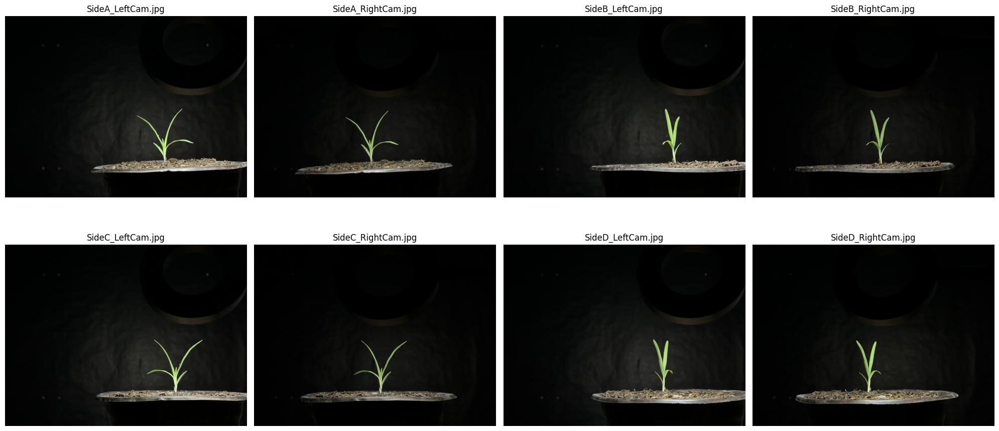

In [ ]:
# Load and resize the stereo images
stereo_images = []
for filename in filenames:
    image_path = os.path.join(stereo_images_path, filename)
    if os.path.exists(image_path):
        img = cv2.imread(image_path)
        img_resized = resize_image(img, scale_percent)
        stereo_images.append(img_resized)
    else:
        print(f"Error: {filename} not found at {image_path}")

# Display stereo images
titles = filenames
display_images(stereo_images, titles)

### Preprocess, and display preprocessed plant images

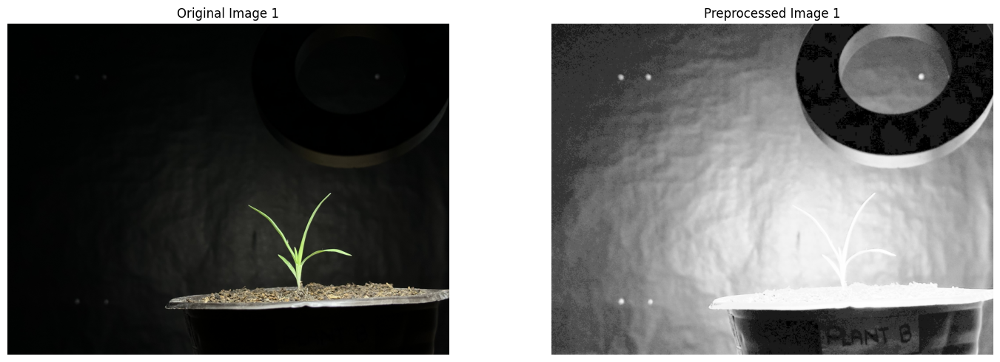

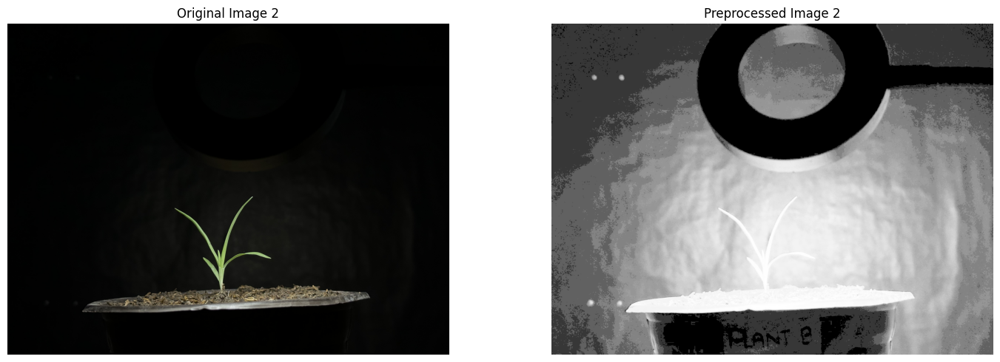

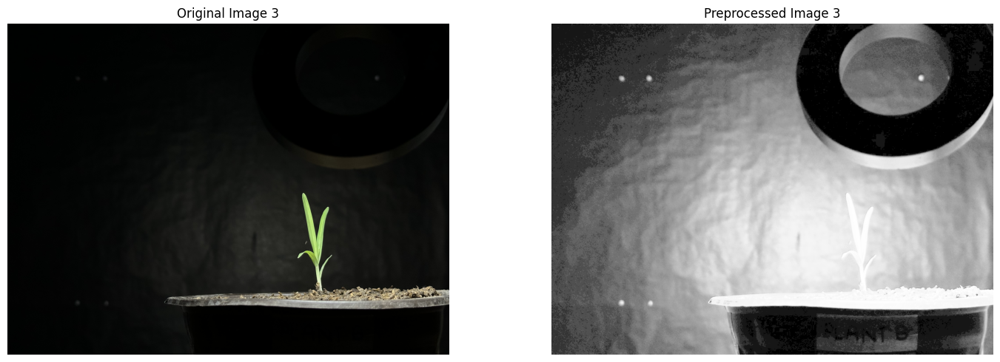

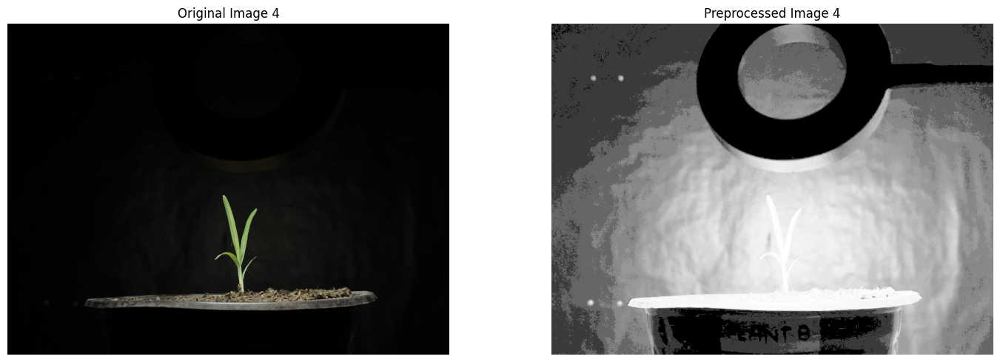

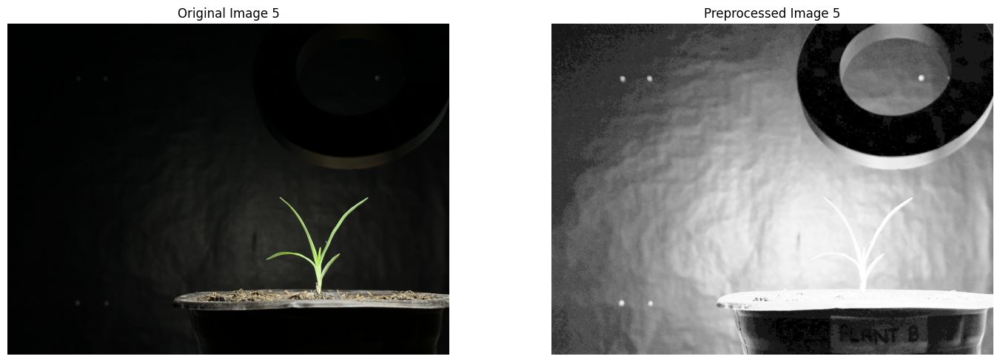

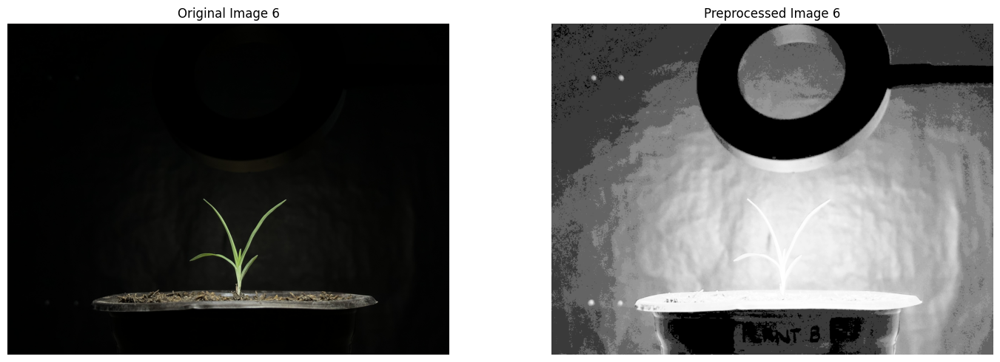

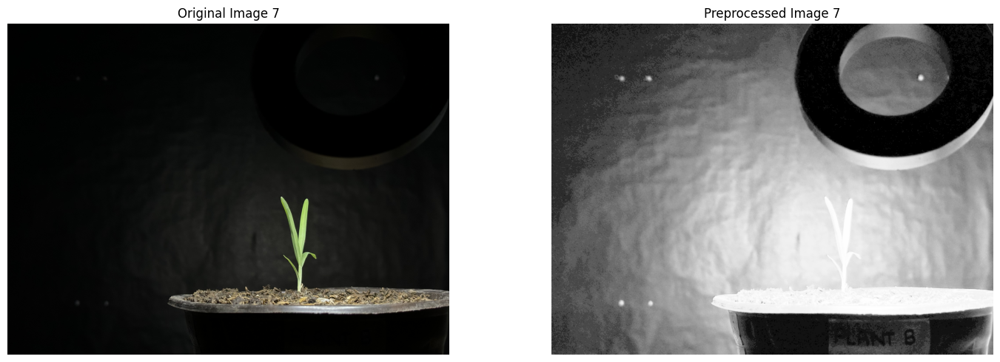

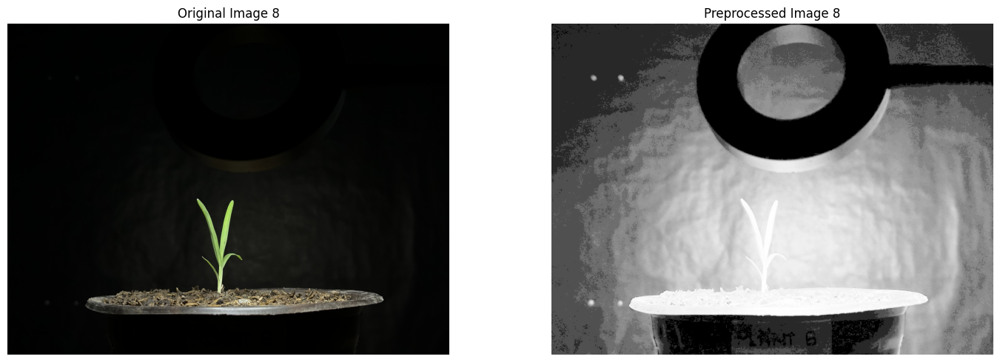

In [ ]:
# Preprocess and store the images
preprocessed_images = []

for idx, img in enumerate(stereo_images):
    preprocessed_img = preprocess_plant_image(img)
    preprocessed_images.append(preprocessed_img)

    # Display original and preprocessed images
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(f'Original Image {idx+1}')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(preprocessed_img, cv2.COLOR_BGR2RGB))
    plt.title(f'Preprocessed Image {idx+1}')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

### Retrieve, and display calibration images

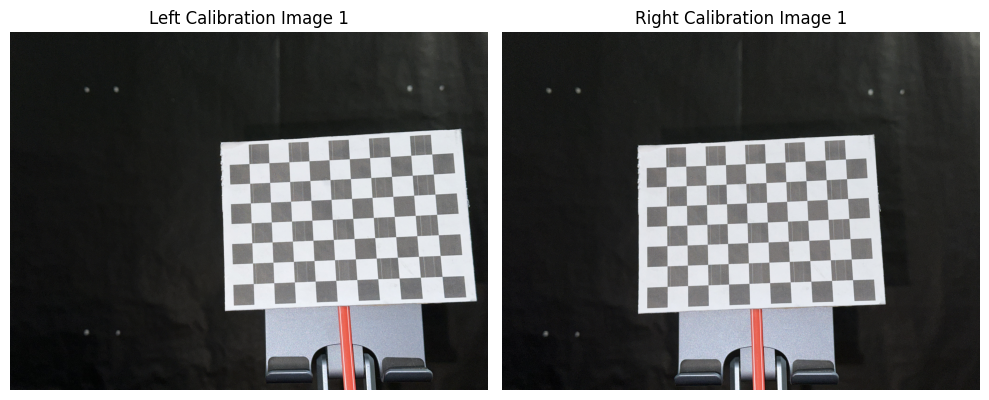

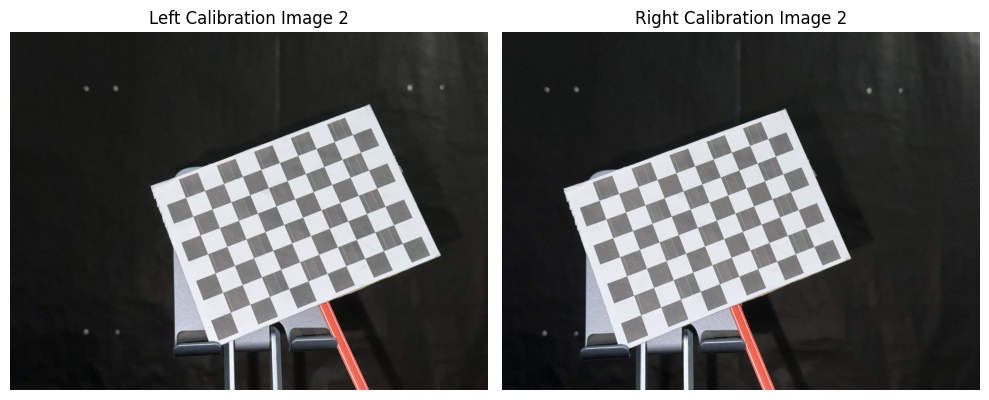

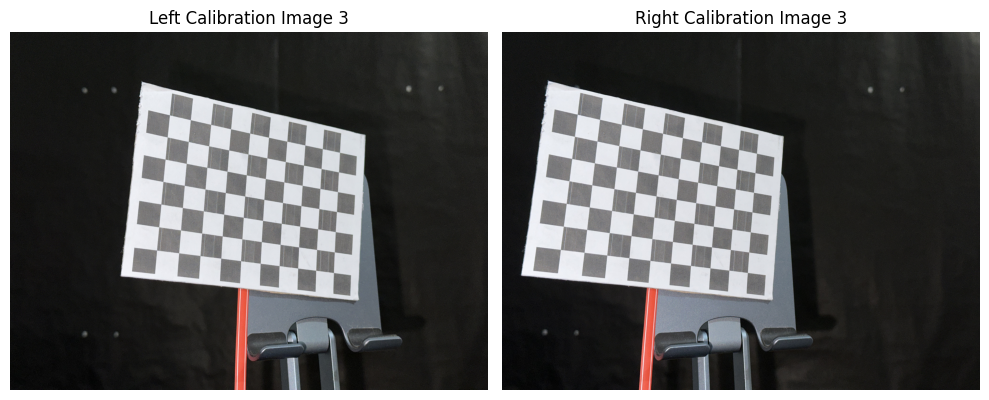

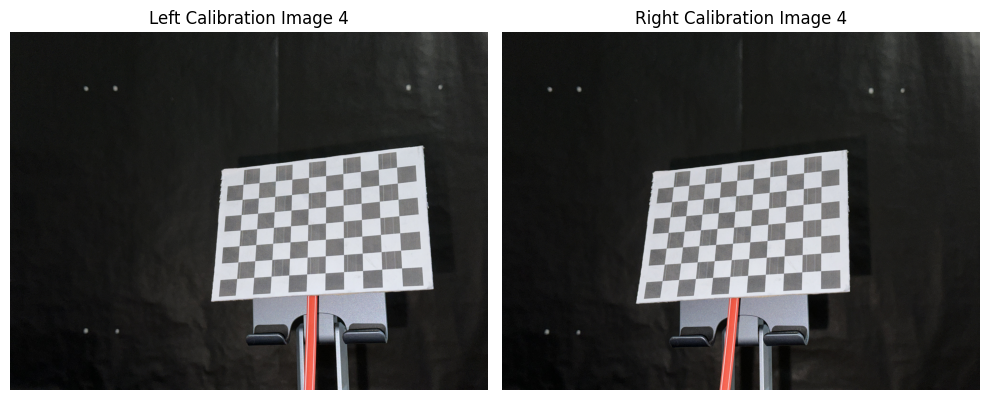

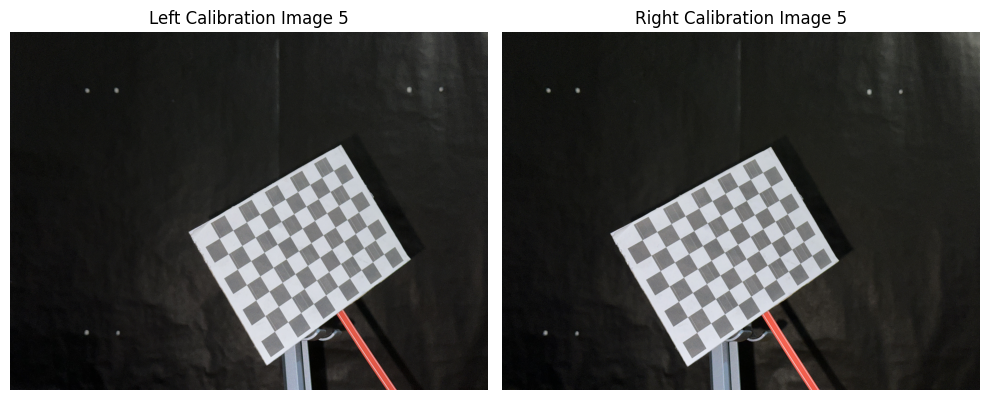

...

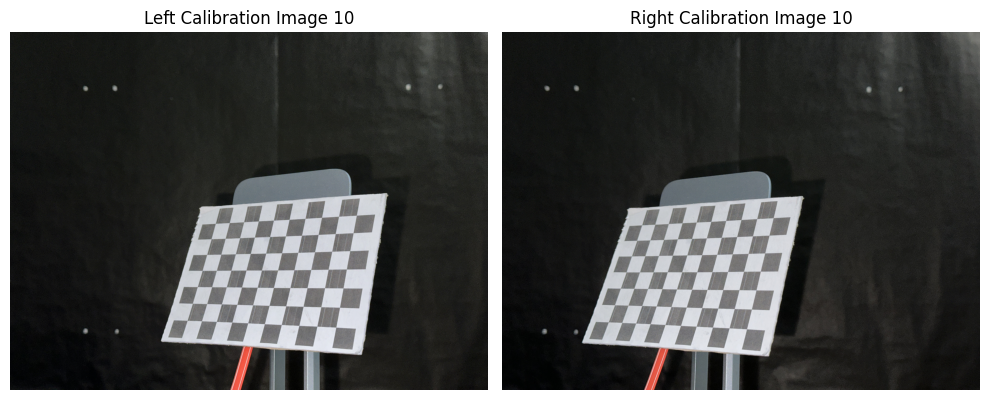

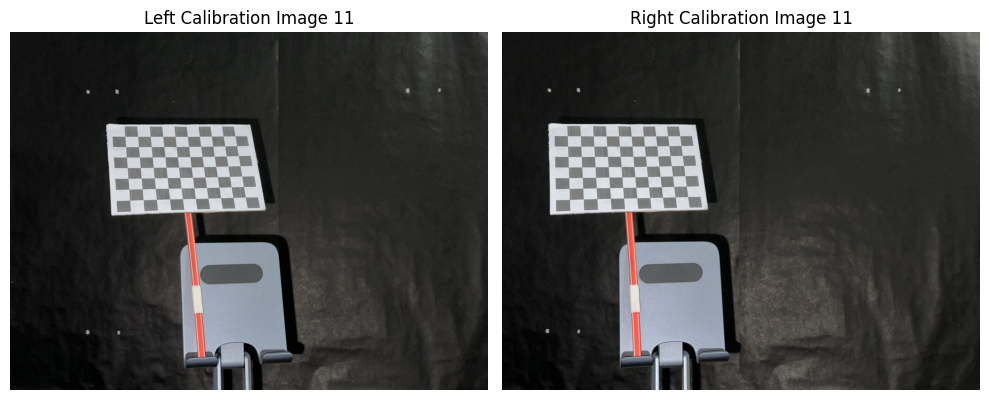

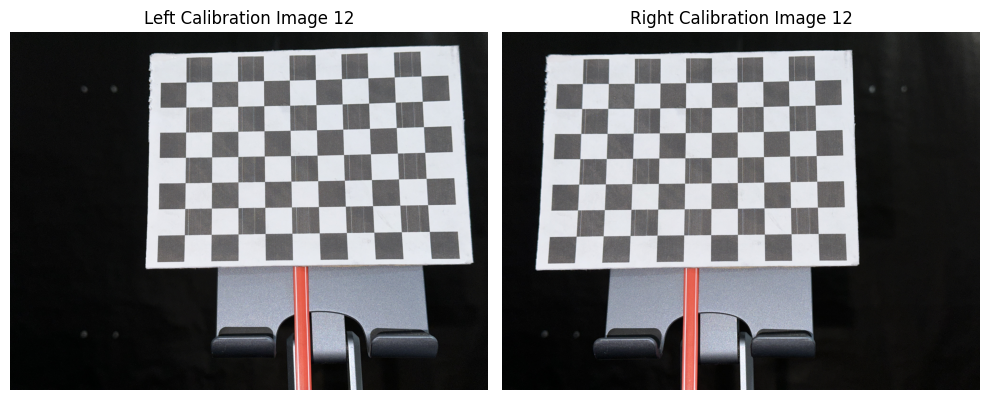

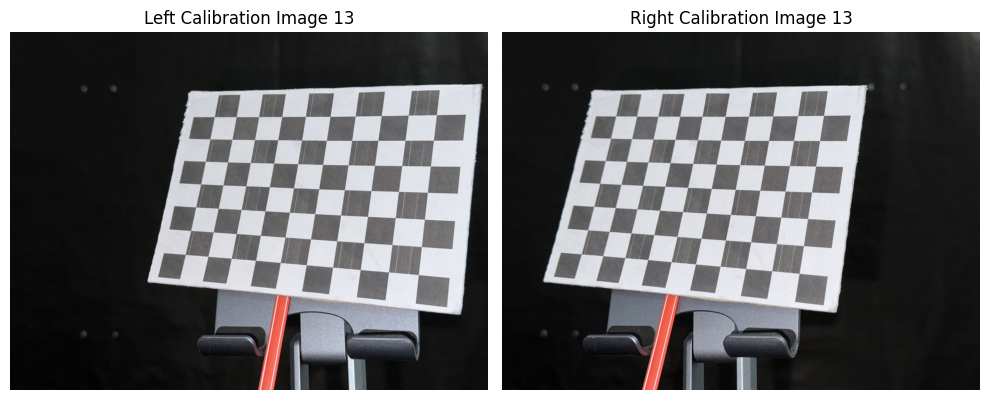

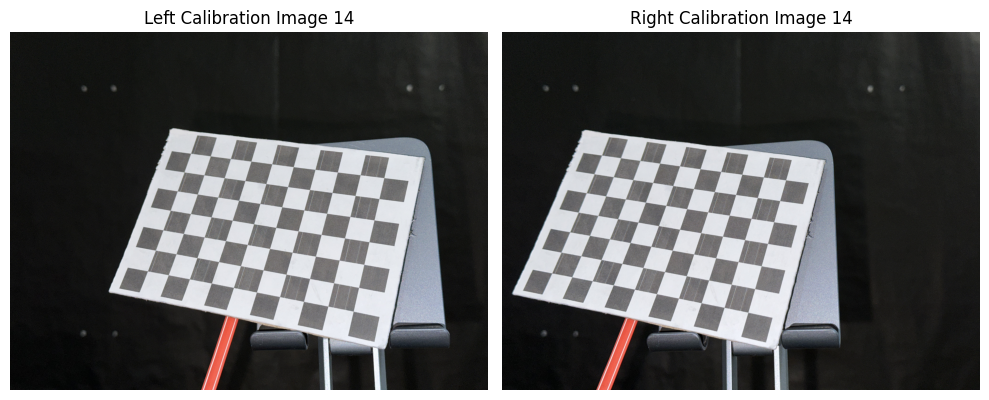

In [ ]:
# Load and display calibration images
left_calib_images = []
right_calib_images = []

for i in range(0, len(calibration_filenames), 2):
    left_img_path = os.path.join(calibration_images_path, calibration_filenames[i])
    right_img_path = os.path.join(calibration_images_path, calibration_filenames[i+1])

    if os.path.exists(left_img_path) and os.path.exists(right_img_path):
        # Load images
        left_img = cv2.imread(left_img_path)
        right_img = cv2.imread(right_img_path)

        # Resize images
        left_img_resized = resize_image(left_img, scale_percent)
        right_img_resized = resize_image(right_img, scale_percent)

        # Store images
        left_calib_images.append(left_img_resized)
        right_calib_images.append(right_img_resized)

        # Display images
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(left_img_resized, cv2.COLOR_BGR2RGB))
        plt.title(f'Left Calibration Image {i//2 + 1}')
        plt.axis('off')
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(right_img_resized, cv2.COLOR_BGR2RGB))
        plt.title(f'Right Calibration Image {i//2 + 1}')
        plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print(f"Error: Calibration images {calibration_filenames[i]} or {calibration_filenames[i+1]} not found.")

### Preprocess, and display preprocessed calibration images

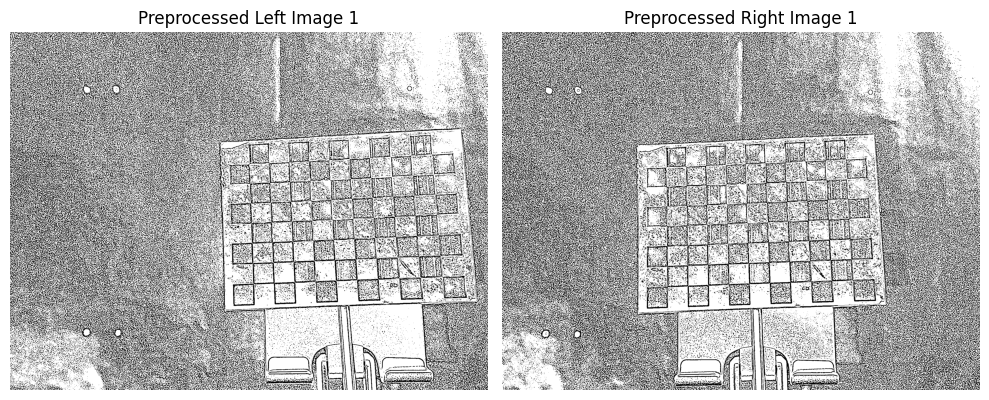

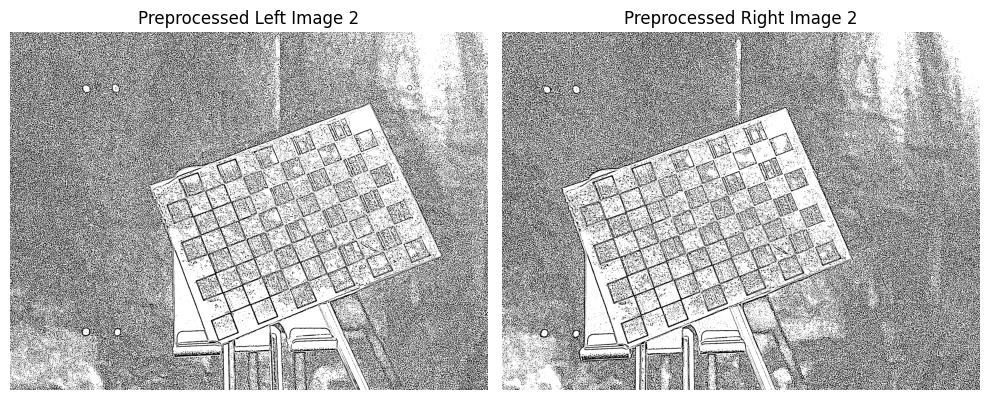

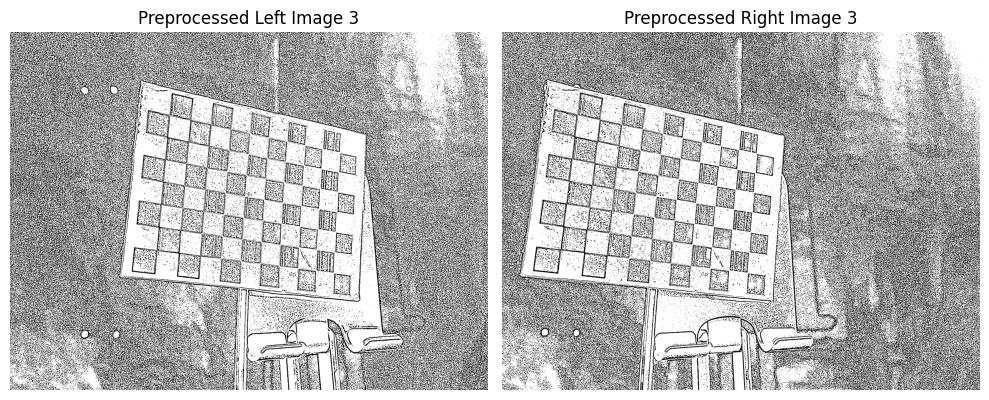

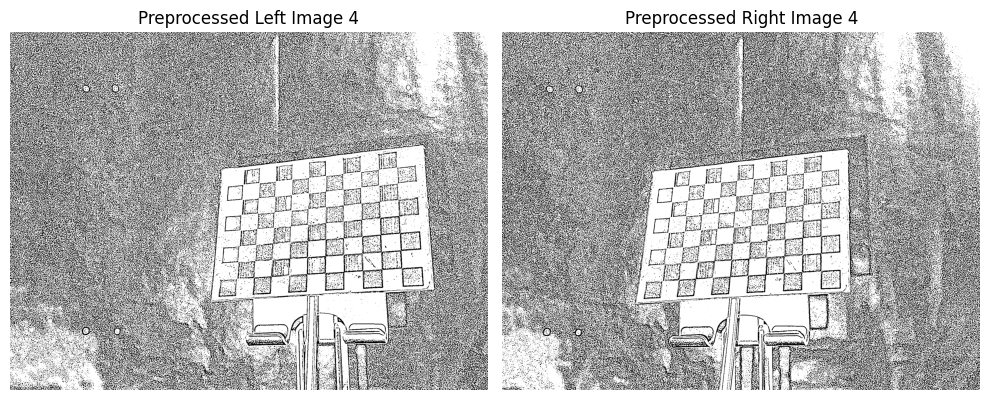

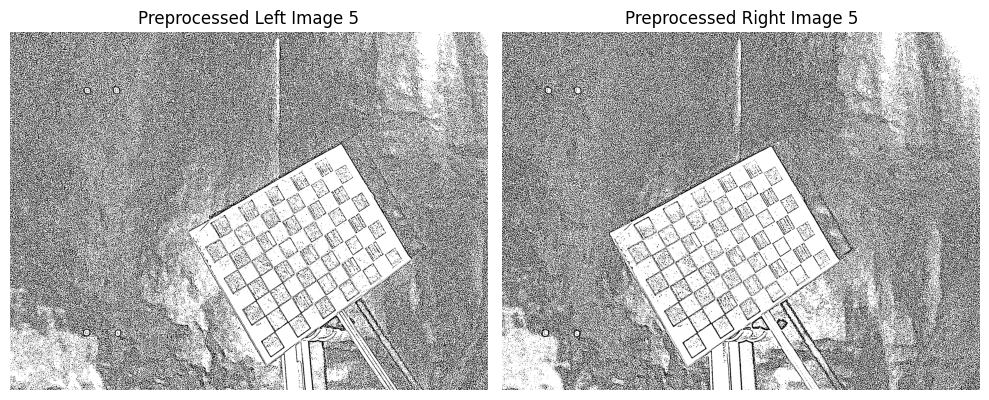

...

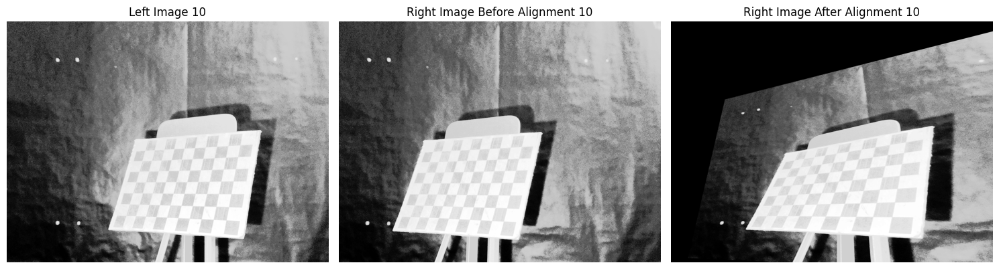

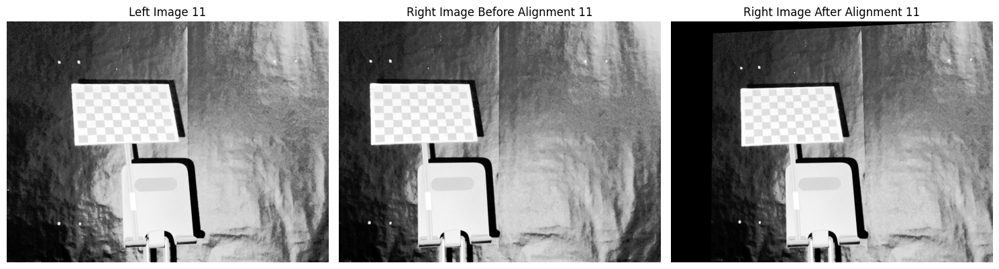

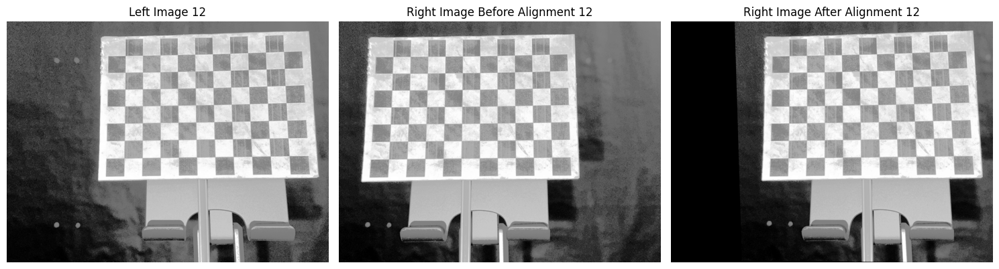

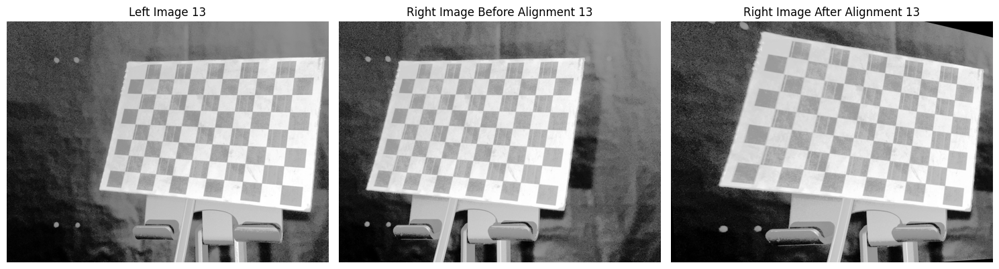

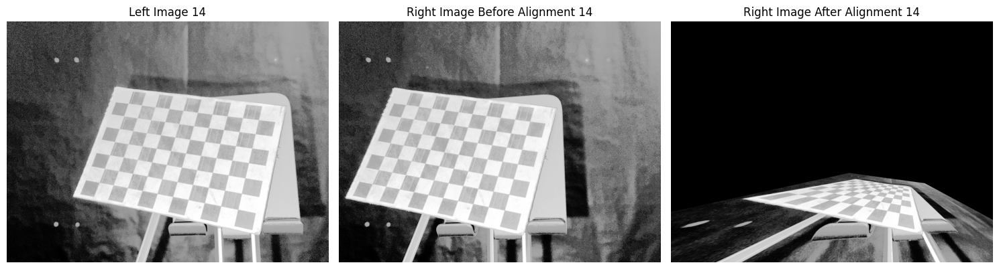

In [ ]:
preprocessed_left_images = []
preprocessed_right_images = []
gray_left_images = []
gray_right_images = []

for idx, (left_img, right_img) in enumerate(zip(left_calib_images, right_calib_images)):
    # Preprocess images
    gray_left, preprocessed_left = preprocess_calibration_image(left_img)
    gray_right, preprocessed_right = preprocess_calibration_image(right_img)

    gray_left_images.append(gray_left)
    gray_right_images.append(gray_right)
    preprocessed_left_images.append(preprocessed_left)
    preprocessed_right_images.append(preprocessed_right)

    # Display preprocessed images
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(preprocessed_left, cmap='gray')
    plt.title(f'Preprocessed Left Image {idx+1}')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(preprocessed_right, cmap='gray')
    plt.title(f'Preprocessed Right Image {idx+1}')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

aligned_right_images = []
homographies = []

for idx, (gray_left, gray_right) in enumerate(zip(gray_left_images, gray_right_images)):
    # Histogram matching
    right_img_matched = match_histograms(gray_right, gray_left)

    # Feature-based alignment
    right_img_aligned, M = align_images(gray_left, right_img_matched, idx)
    homographies.append(M)
    aligned_right_images.append(right_img_aligned)

    # Display alignment results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(gray_left, cmap='gray')
    plt.title(f'Left Image {idx+1}')
    plt.axis('off')
    plt.subplot(1, 3, 2)
    plt.imshow(right_img_matched, cmap='gray')
    plt.title(f'Right Image Before Alignment {idx+1}')
    plt.axis('off')
    plt.subplot(1, 3, 3)
    plt.imshow(right_img_aligned, cmap='gray')
    plt.title(f'Right Image After Alignment {idx+1}')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

## Camera Calibration and Rectification

### Generate calibration data, and display corner detection results

In [ ]:
# Camera calibration parameters
# --- MANIPULATE ---
checkerboard_size = (10, 7)  # Internal corners per chessboard row and column
# --- MANIPULATE ---
square_size = 12.5  # Size of a square in your defined unit (cm)

# Prepare object points
objp = np.zeros((checkerboard_size[0]*checkerboard_size[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:checkerboard_size[0], 0:checkerboard_size[1]].T.reshape(-1, 2)
objp *= square_size

# Arrays to store object points and image points
objpoints = []        # 3d point in real world space
imgpoints_left = []   # 2d points in image plane.
imgpoints_right = []

# Termination criteria for corner refinement
# --- MANIPULATE ---
  # Parameter: criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, max_iter, epsilon)
  # max_iter: Maximum number of iterations (e.g., 30, 50, 100).
  # epsilon: Desired accuracy (e.g., 0.001, 0.01).
  # Increase max_iter: Allows more iterations for corner refinement, which might improve accuracy but increases computation time.
  # Adjust epsilon: A smaller epsilon requires more precise corner localization.
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

valid_pairs = 0  # Counter for valid calibration pairs

# Find chessboard corners and calibrate
for idx, (left_img, right_img) in enumerate(zip(preprocessed_left_images, aligned_right_images)):
    # Find chessboard corners
    # --- MANIPULATE ---
      # Use additional flags like cv2.CALIB_CB_ADAPTIVE_THRESH, cv2.CALIB_CB_NORMALIZE_IMAGE, cv2.CALIB_CB_FAST_CHECK. Try different combinations.
      # Example: ret_left, corners_left = cv2.findChessboardCornersSB(left_img, checkerboard_size, flags=cv2.CALIB_CB_NORMALIZE_IMAGE)
      # CALIB_CB_ADAPTIVE_THRESH: Uses adaptive thresholding before finding corners.
      # CALIB_CB_NORMALIZE_IMAGE: Normalizes the image gamma for better contrast.
      # CALIB_CB_FAST_CHECK: Shortcuts the function if it can’t find a chessboard (faster but less thorough).
    # --- MANIPULATE ---
      # cv2.findChessboardCorners vs. cv2.findChessboardCornersSB: Switch between these functions to see which performs better.
    ret_left, corners_left = cv2.findChessboardCornersSB(left_img, checkerboard_size, None)
    ret_right, corners_right = cv2.findChessboardCornersSB(right_img, checkerboard_size, None)

    if ret_left and ret_right:
        objpoints.append(objp)

        # Refine corner locations
        corners_left = cv2.cornerSubPix(left_img, corners_left, (11,11), (-1,-1), criteria)
        corners_right = cv2.cornerSubPix(right_img, corners_right, (11,11), (-1,-1), criteria)

        imgpoints_left.append(corners_left)
        imgpoints_right.append(corners_right)
        valid_pairs += 1

        # Draw and display the corners
        left_img_color = cv2.cvtColor(left_img, cv2.COLOR_GRAY2BGR)
        right_img_color = cv2.cvtColor(right_img, cv2.COLOR_GRAY2BGR)
        cv2.drawChessboardCorners(left_img_color, checkerboard_size, corners_left, ret_left)
        cv2.drawChessboardCorners(right_img_color, checkerboard_size, corners_right, ret_right)

        # Display the images with detected corners
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(cv2.cvtColor(left_img_color, cv2.COLOR_BGR2RGB))
        axs[0].set_title(f'Left Calibration Image {idx+1} with Corners')
        axs[0].axis('off')

        axs[1].imshow(cv2.cvtColor(right_img_color, cv2.COLOR_BGR2RGB))
        axs[1].set_title(f'Right Calibration Image {idx+1} with Corners')
        axs[1].axis('off')

        plt.tight_layout()
        plt.show()
    else:
        print(f"Skipping calibration image pair {idx+1} due to detection failure.")

# Check if sufficient valid pairs were found
if valid_pairs < 2:
    print("Error: Not enough valid calibration images for stereo calibration.")
else:
    print(f"Number of valid calibration pairs: {valid_pairs}")

    # Stereo calibration
    ret, cameraMatrix1, distCoeffs1, cameraMatrix2, distCoeffs2, R, T, E, F = cv2.stereoCalibrate(
        objpoints,
        imgpoints_left,
        imgpoints_right,
        None, None, None, None,
        left_img.shape[::-1],
        criteria=criteria,
        flags=cv2.CALIB_FIX_INTRINSIC
    )

    # Stereo rectification
    R1, R2, P1, P2, Q, roi1, roi2 = cv2.stereoRectify(
        cameraMatrix1, distCoeffs1,
        cameraMatrix2, distCoeffs2,
        left_img.shape[::-1], R, T
    )

    # Save calibration data
    fs = cv2.FileStorage(calibration_data_path, cv2.FILE_STORAGE_WRITE)
    fs.write("cameraMatrix1", cameraMatrix1)
    fs.write("distCoeffs1", distCoeffs1)
    fs.write("cameraMatrix2", cameraMatrix2)
    fs.write("distCoeffs2", distCoeffs2)
    fs.write("R", R)
    fs.write("T", T)
    fs.write("R1", R1)
    fs.write("R2", R2)
    fs.write("P1", P1)
    fs.write("P2", P2)
    fs.write("Q", Q)
    fs.release()
    print(f"Calibration data saved to {calibration_data_path}")

Skipping calibration image pair 1 due to detection failure.
Skipping calibration image pair 2 due to detection failure.
Skipping calibration image pair 3 due to detection failure.
Skipping calibration image pair 4 due to detection failure.
Skipping calibration image pair 5 due to detection failure.
Skipping calibration image pair 6 due to detection failure.
Skipping calibration image pair 7 due to detection failure.
Skipping calibration image pair 8 due to detection failure.
Skipping calibration image pair 9 due to detection failure.
Skipping calibration image pair 10 due to detection failure.
Skipping calibration image pair 11 due to detection failure.
Skipping calibration image pair 12 due to detection failure.
Skipping calibration image pair 13 due to detection failure.
Skipping calibration image pair 14 due to detection failure.
Error: Not enough valid calibration images for stereo calibration.


## Image Segmentation, and Segmentation Mask Generation

### Segment plant objects

In [ ]:
# Segment images and get masks using preprocessed images
segmented_images = []
segmentation_masks = []

for img, filename in zip(preprocessed_images, filenames):
    segmented_img, mask = segment_plant(img, filename, model)
    segmented_images.append(segmented_img)
    segmentation_masks.append(mask.astype(np.uint8))

Ultralytics YOLOv8.0.28 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU
YOLOv8s-seg summary (fused): 195 layers, 11779987 parameters, 0 gradients, 42.4 GFLOPs


No plant detected in image SideA_LeftCam.jpg. Returning original image.
No plant detected in image SideA_RightCam.jpg. Returning original image.
No plant detected in image SideB_RightCam.jpg. Returning original image.


### Save segmented images

In [ ]:
# Save the segmented images
for segmented_img, filename in zip(segmented_images, filenames):
    save_path = os.path.join(segmented_images_path, f'Segmented_{filename}')
    cv2.imwrite(save_path, segmented_img)
    print(f"Segmented image saved to {save_path}")

Segmented image saved to /content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our 3D Construction/Files/Segmented plants/Segmented_SideA_LeftCam.jpg
Segmented image saved to /content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our 3D Construction/Files/Segmented plants/Segmented_SideA_RightCam.jpg
Segmented image saved to /content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our 3D Construction/Files/Segmented plants/Segmented_SideB_LeftCam.jpg
Segmented image saved to /content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our 3D Construction/Files/Segmented plants/Segmented_SideB_RightCam.jpg
Segmented image saved to /content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our 3D Construction/Files/Segmented plants/Segmented_SideC_LeftCam.jpg
Segmented image saved to /content/drive/MyDrive/Research Files/Other files/Development/3D Construction/Our 3D Construction/Files

### Display segmented images and segmentation mask

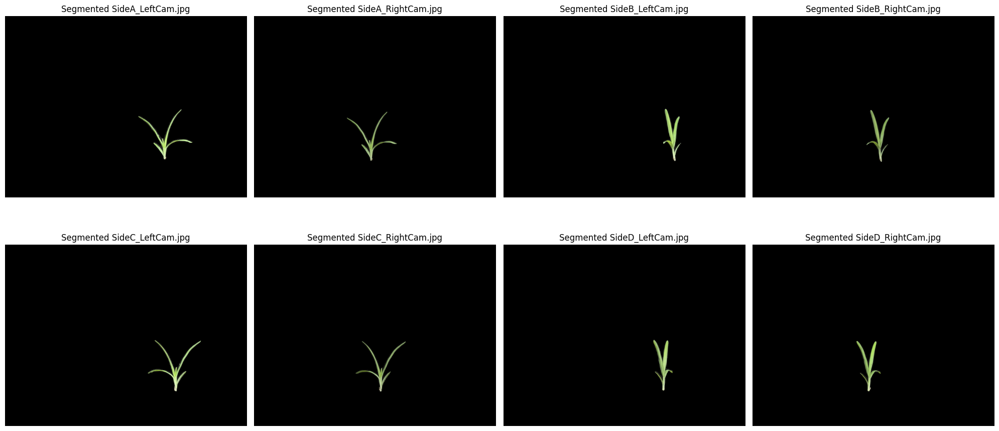

In [ ]:
# Display segmented images and masks
for idx, (segmented_img, mask, filename) in enumerate(zip(segmented_images, segmentation_masks, filenames)):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(segmented_img, cv2.COLOR_BGR2RGB))
    plt.title(f'Segmented Image {filename}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.title(f'Segmentation Mask {filename}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

## Depth Map Generation

### Generate depth maps

In [ ]:
# Load calibration data from XML file
fs = cv2.FileStorage(calibration_data_path, cv2.FILE_STORAGE_READ)
cameraMatrix1 = fs.getNode("cameraMatrix1").mat()
distCoeffs1 = fs.getNode("distCoeffs1").mat()
cameraMatrix2 = fs.getNode("cameraMatrix2").mat()
distCoeffs2 = fs.getNode("distCoeffs2").mat()
R = fs.getNode("R").mat()
T = fs.getNode("T").mat()
R1 = fs.getNode("R1").mat()
R2 = fs.getNode("R2").mat()
P1 = fs.getNode("P1").mat()
P2 = fs.getNode("P2").mat()
Q = fs.getNode("Q").mat()
fs.release()

# Initialize StereoSGBM matcher with adjusted parameters
image_height, image_width = preprocessed_images[0].shape[:2]
num_disparities = 16 * 5  # Must be divisible by 16
block_size = 7  # Adjust based on image resolution

# Create stereo matchers and WLS filter
left_matcher = cv2.StereoSGBM_create(
    minDisparity=0,
    numDisparities=num_disparities,
    blockSize=block_size,
    P1=8 * block_size ** 2,
    P2=32 * block_size ** 2,
    disp12MaxDiff=1,
    uniquenessRatio=5,        # Adjusted
    speckleWindowSize=50,     # Adjusted
    speckleRange=16           # Adjusted
)
right_matcher = cv2.ximgproc.createRightMatcher(left_matcher)

wls_filter = cv2.ximgproc.createDisparityWLSFilter(matcher_left=left_matcher)
wls_filter.setLambda(8000)
wls_filter.setSigmaColor(1.5)

# Compute rectification maps
map1_left, map2_left = cv2.initUndistortRectifyMap(
    cameraMatrix1, distCoeffs1, R1, P1, (image_width, image_height), cv2.CV_16SC2
)
map1_right, map2_right = cv2.initUndistortRectifyMap(
    cameraMatrix2, distCoeffs2, R2, P2, (image_width, image_height), cv2.CV_16SC2
)

# Initialize list to store depth maps
depth_maps = []
homographies = []

for idx in range(0, len(preprocessed_images), 2):
    # Preprocessed images
    left_img_orig = preprocessed_images[idx]
    right_img_orig = preprocessed_images[idx + 1]

    # Corresponding segmentation masks
    left_mask = segmentation_masks[idx]
    right_mask = segmentation_masks[idx + 1]

    # Apply rectification to images
    left_img_rect = cv2.remap(left_img_orig, map1_left, map2_left, cv2.INTER_LINEAR)
    right_img_rect = cv2.remap(right_img_orig, map1_right, map2_right, cv2.INTER_LINEAR)

    # Display rectified images
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(left_img_rect, cv2.COLOR_BGR2RGB))
    plt.title(f'Rectified Left Image {idx//2 + 1}')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(right_img_rect, cv2.COLOR_BGR2RGB))
    plt.title(f'Rectified Right Image {idx//2 + 1}')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Convert images to grayscale
    gray_left = cv2.cvtColor(left_img_rect, cv2.COLOR_BGR2GRAY)
    gray_right = cv2.cvtColor(right_img_rect, cv2.COLOR_BGR2GRAY)

    # Histogram matching
    gray_right_matched = match_histograms(gray_right, gray_left)

    # Display histogram matching results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(gray_left, cmap='gray')
    plt.title('Gray Left Image')
    plt.axis('off')
    plt.subplot(1, 3, 2)
    plt.imshow(gray_right, cmap='gray')
    plt.title('Gray Right Image Before Matching')
    plt.axis('off')
    plt.subplot(1, 3, 3)
    plt.imshow(gray_right_matched, cmap='gray')
    plt.title('Gray Right Image After Matching')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Feature-based alignment
    gray_right_aligned, M = align_images(gray_left, gray_right_matched, idx)
    homographies.append(M)  # Store homography for later use

    # Display alignment results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(gray_left, cmap='gray')
    plt.title('Gray Left Image')
    plt.axis('off')
    plt.subplot(1, 3, 2)
    plt.imshow(gray_right_matched, cmap='gray')
    plt.title('Gray Right Image Before Alignment')
    plt.axis('off')
    plt.subplot(1, 3, 3)
    plt.imshow(gray_right_aligned, cmap='gray')
    plt.title('Gray Right Image After Alignment')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Warp right rectified image and mask using homography
    right_img_rect_aligned = cv2.warpPerspective(right_img_rect, M, (image_width, image_height))
    right_mask_rect_aligned = cv2.warpPerspective(right_mask, M, (image_width, image_height), flags=cv2.INTER_NEAREST)

    # Compute disparity map
    disparity_filtered = compute_disparity_map(gray_left, gray_right_aligned, left_matcher, right_matcher, wls_filter)

    # Apply masks to disparity map
    left_mask_rect = cv2.remap(left_mask, map1_left, map2_left, cv2.INTER_NEAREST)
    disparity_filtered_masked, combined_mask = apply_masks(disparity_filtered, left_mask_rect, right_mask_rect_aligned)

    # Append to depth_maps list
    depth_maps.append(disparity_filtered_masked)

    # Display disparity maps
    plt.figure(figsize=(20, 10))

    # Disparity after WLS filtering
    plt.subplot(2, 3, 1)
    disp_filtered_norm = cv2.normalize(disparity_filtered, None, 0, 255, cv2.NORM_MINMAX)
    plt.imshow(disp_filtered_norm.astype(np.uint8), cmap='jet')
    plt.title(f'Disparity Map After WLS Filtering {idx//2 + 1}')
    plt.axis('off')

    # Combined mask
    plt.subplot(2, 3, 2)
    plt.imshow(combined_mask, cmap='gray')
    plt.title(f'Combined Mask {idx//2 + 1}')
    plt.axis('off')

    # Disparity after masking
    plt.subplot(2, 3, 3)
    disp_masked_norm = cv2.normalize(disparity_filtered_masked, None, 0, 255, cv2.NORM_MINMAX)
    plt.imshow(disp_masked_norm.astype(np.uint8), cmap='jet')
    plt.title(f'Disparity Map After Masking {idx//2 + 1}')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

### Save depth maps

In [ ]:
# Save depth maps to files
for i, depth_map in enumerate(depth_maps):
    save_path = os.path.join(depth_maps_path, f'DepthMap_{i+1}.npy')
    np.save(save_path, depth_map)
    print(f'Depth map {i+1} saved to {save_path}')

### Display depth maps

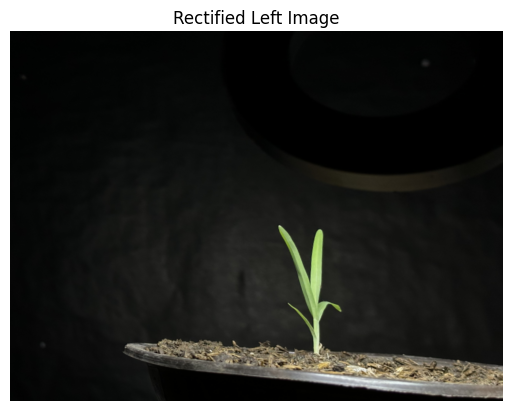

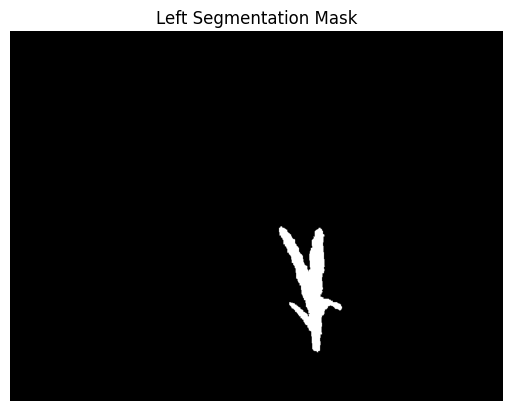

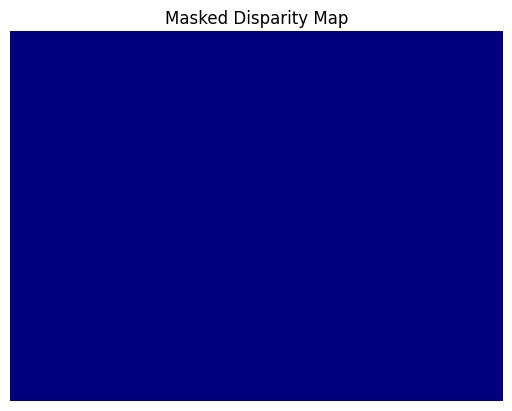

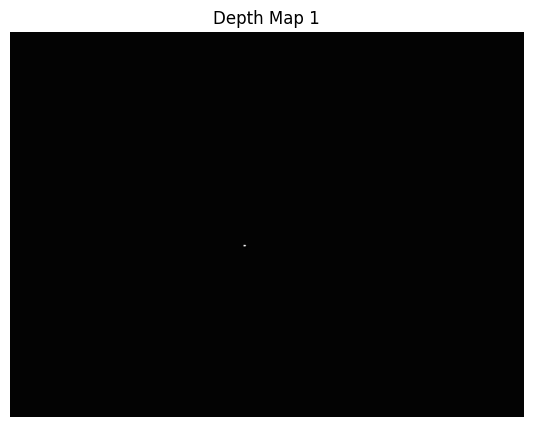

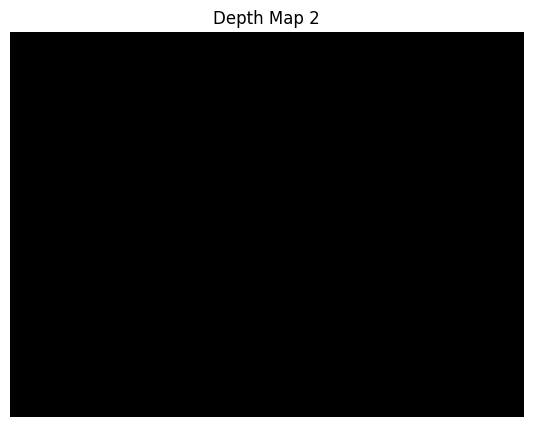

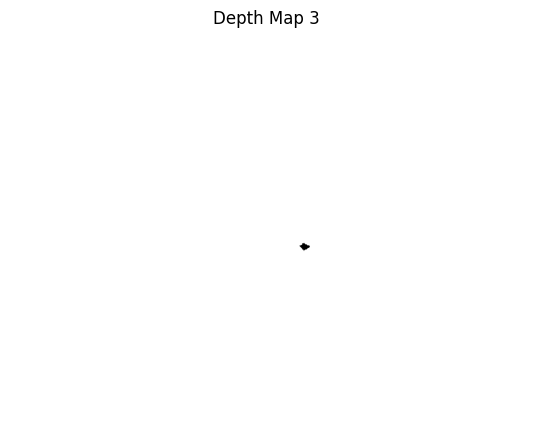

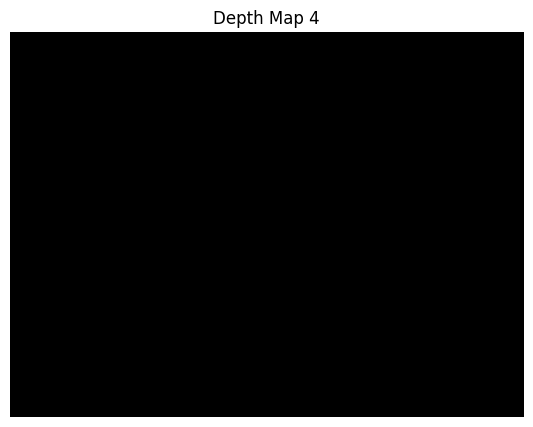

In [ ]:
# Display all depth maps
for i, depth_map in enumerate(depth_maps):
    plt.figure(figsize=(10, 5))
    disp_norm = cv2.normalize(depth_map, None, 0, 255, cv2.NORM_MINMAX)
    plt.imshow(disp_norm.astype(np.uint8), cmap='jet')
    plt.title(f'Depth Map {i+1}')
    plt.axis('off')
    plt.show()

## Point Cloud Generation

### Generate point clouds

In [ ]:
point_clouds = []
for idx, depth_map in enumerate(depth_maps):
    # Get corresponding left image for colors
    color_image = segmented_images[idx*2]

    # Reproject to 3D
    points_3D = cv2.reprojectImageTo3D(depth_map, Q)
    mask = depth_map > depth_map.min()

    # Apply mask to points and colors
    points = points_3D[mask]
    colors = cv2.cvtColor(color_image, cv2.COLOR_BGR2RGB)
    colors = colors[mask]

    # Create Open3D point cloud
    pc = o3d.geometry.PointCloud()
    pc.points = o3d.utility.Vector3dVector(points)
    pc.colors = o3d.utility.Vector3dVector(colors / 255.0)
    point_clouds.append(pc)

### Save point clouds

In [ ]:
# Save the point clouds
for i, pc in enumerate(point_clouds):
    save_path = os.path.join(point_clouds_path, f'PointCloud_{i+1}.ply')
    o3d.io.write_point_cloud(save_path, pc)

### Display point clouds

In [ ]:
# Display the point clouds
for i, pc in enumerate(point_clouds):
    print(f'Displaying Point Cloud {i+1}')
    o3d.visualization.draw_geometries([pc])

## Point Cloud Registration

### Merge point clouds

In [ ]:
# Merge the point clouds using ICP registration
merged_pc = point_clouds[0]
for i in range(1, len(point_clouds)):
    print(f'Registering Point Cloud {i+1} to the merged point cloud')
    threshold = 0.02  # Adjust as needed
    trans_init = np.eye(4)
    reg_p2p = o3d.pipelines.registration.registration_icp(
        point_clouds[i], merged_pc, threshold, trans_init,
        o3d.pipelines.registration.TransformationEstimationPointToPoint()
    )
    print(f'Transformation Matrix for Point Cloud {i+1}:\n', reg_p2p.transformation)
    point_clouds[i].transform(reg_p2p.transformation)
    merged_pc += point_clouds[i]
    merged_pc = merged_pc.voxel_down_sample(voxel_size=0.005)

### Save merged point cloud

In [ ]:
# Save the merged point cloud
save_path = os.path.join(merged_pc_path, 'MergedPointCloud.ply')
o3d.io.write_point_cloud(save_path, merged_pc)

### Display merged point cloud

In [ ]:
# Display the merged point cloud
print("Displaying the merged point cloud")
o3d.visualization.draw_geometries([merged_pc])

## Mesh Generation

### Generate mesh from merged point cloud

In [ ]:
# Generate mesh using Poisson surface reconstruction
print("Generating mesh from the merged point cloud...")
with o3d.utility.VerbosityContextManager(o3d.utility.VerbosityLevel.Debug):
    mesh, densities = o3d.geometry.TriangleMesh.create_from_point_cloud_poisson(
        merged_pc, depth=9
    )

# Remove low-density vertices to clean up the mesh
vertices_to_remove = densities < np.quantile(densities, 0.01)
mesh.remove_vertices_by_mask(vertices_to_remove)

### Save 3D mesh model

In [ ]:
# Save the meshed model
save_path = os.path.join(meshed_model_path, 'MeshedModel.ply')
o3d.io.write_triangle_mesh(save_path, mesh)

### Display 3D mesh model

In [ ]:
# Display the meshed model
print("Displaying the meshed model")
o3d.visualization.draw_geometries([mesh])